In [1]:
import gym
from gym import spaces
import numpy as np
import matplotlib.pyplot as plt

## Implementing Environment

In [2]:
# Imports
import numpy as np
import matplotlib.pyplot as plt
import math
import itertools
import pickle

In [3]:
from pettingzoo.mpe import simple_adversary_v3,simple_v3

env = simple_v3.env(max_cycles=50, continuous_actions=False,render_mode="human")
env.reset(seed=42)

## Actor Critic Without Function Approximation

In [4]:

# Actor Critic Algorithm class
class Actor_Critic(object):
    # Main class to train the TD algorithm for the n number of episodes
    # the class takes the policy, alpha and lambda as the input
    def __init__(self, gamma, alpha_critic, alpha_actor, env, steps,  order=3, actions=8, plot=False, discount=0.99, lambda_=0.1):
        self.alpha_critic = alpha_critic
        self.alpha_actor = alpha_actor
        self.gamma = gamma
        self.env = env
        self.state_space = 400
        self.steps = steps
        self.lambda_ = lambda_
        self.td_error = []
        self.reward = []
        self.order = order
        self.probs = [0.25, 0.25, 0.25, 0.25]
        self.plot = plot
        self.episodes =4000
        self.scale = 20
        self.discount = discount
        self.actions = 5
        # self.q_value = np.random.uniform(0, 1, size= (state_space, actions))
        self.w = np.zeros((self.state_space, 1))
        self.theta = np.zeros((self.state_space, self.actions))
        self.eligibility_v = np.zeros((self.state_space, 1))
        self.eligibility_theta = np.zeros((self.state_space, self.actions))
        self.normalization_min = np.array([-1.2, -0.07])
        self.normalization_denominator = np.array([2.4, 0.14])
        self.epsilon_decay = 0.004
        self.epsilon_decay = 1000

    # Function for get single state
    def get_single_state(self, state):
        new_state = []
        for position in range(len(state)):
            new_value = (state[position] + 2)
            if new_value < 0 :
              new_value = 0
            if new_value > 4 :
              new_value = 4
            new_state.append(int(round(new_value, 0)))
        single_state = int(new_state[0]/0.2   - 1 )*self.scale + int(new_state[1]/0.2) -1

        return single_state




    
    def train(self):
        # Method to run the actor critic algorithm for n episodes
        # input: episodes, trails
        # return: None
        # While we do not reach the terminal state
        # Getting action
        self.eligibility_v = np.zeros((400, 1))
        self.eligibility_theta = np.zeros((400, 5))





        for i in range(self.episodes):

            env.reset(seed =42)
            termination = False
            truncation = False
            observation, reward, termination, truncation, info = env.last()

            state = self.get_single_state(observation)


            # local variable to store the variable
            count = 0 # count
            episode_reward = 0 # episode reward
            steps = 0
            ep_reward = []
            self.decay_epsilon(self.episodes +1 )
            while not termination and not truncation:
                steps += 1
                action, policy= self.sampleActionGrid(state)
                # Getting action # todo make changes as per policy softmax check the implementation

                # performing the action in the environment and observing the reward and moving to the new state s_prime
                self.env.step(action)
                next_observation, reward, termination, truncation, info = env.last()
                ep_reward.append(reward)
                new_state = self.get_single_state(next_observation)
                count += 1
                episode_reward += (self.discount**count)*reward

                # update the q values according to the previous state and new state
                self.update(reward, state, action, new_state)

                # changing the last state to new state
                state = new_state
                if np.abs(reward) < 0.02:
                    print("reach destination",ep_reward)
                    break    
            print(f"episode {i} - steps: {steps} - episode_reward = {np.sum(ep_reward)}")
            self.reward.append(np.sum(ep_reward))


    def update(self, reward, s, action, new_s=None, policy=None):
        # Update the value function
        # input: reward, curr_state, and new state
        # return: None (update)
        # gettting the last value and new value
        curr_state_value = self.w[s][0]
        next_state_value = self.w[new_s][0]

        # computing the td error
        if new_s:
            delta_t = reward + self.gamma*next_state_value - curr_state_value   # td error
        else:
            delta_t = reward

        # updating the value function if episode is under 100 else calculating
        # the squared error and adding the value to the td_error list.
        # Critic Update using TD(lambda)
        self.eligibility_v = self.gamma * self.lambda_ * self.eligibility_v
        self.eligibility_v += 1
        self.w = self.w + self.alpha_critic * delta_t * self.eligibility_v

        # actor update
        # delta_pie = np.zeros((self.state_space, self.actions))
        delta_pie = -1*self.theta[s] #todo check this calculation
        delta_pie[action] = 1 - delta_pie[action] # todo check this calculation

        self.eligibility_theta = self.gamma * self.lambda_ * self.eligibility_theta #(state * action)
        self.eligibility_theta[s] += delta_pie
        self.theta = self.theta + self.alpha_actor * delta_t * self.eligibility_theta


        self.td_error.append(0)

    # tabular
    def sampleActionGrid(self, state, e_greedy=True):
        policy = self.softmax(self.theta[state])
        print("theta" , self.theta[state])
        action = np.random.choice(5, p=policy)
        return action, policy

    # Update epsilon
    def decay_epsilon(self, episode):
        self.epsilon = np.exp(-self.epsilon_decay*(episode+1))*1000


    def softmax(self, x, sigma=0.1):
        
        x = sigma*x
        mx = np.max(x, axis=-1, keepdims=True)
        numerator = np.exp(x - mx)
        denominator = np.sum(numerator, axis=-1, keepdims=True)
        theta_k = numerator / denominator
        print(theta_k)
        return theta_k

    def plotTdError(self):
        plt.plot(self.td_error)
        plt.show()

    def saveTDerror(self):
        if self.env.name == "cart":
            name = "TD_error/grid" + "_" + str(self.order) + "_" + str(self.alpha) + ".p"
        else:
            name = "TD_error/grid" + "_" + str(self.alpha) + ".p"
        pickle.dump(self.td_error, open(name , "wb"))

In [5]:
ac = Actor_Critic(0.1, 
                  0.01, 
                  0.2, 
                  env, 
                  50,
                  lambda_ = 0.99)

In [6]:
ac.train()

[0.2 0.2 0.2 0.2 0.2]
theta [0. 0. 0. 0. 0.]
[0.19905472 0.20023632 0.20023632 0.20023632 0.20023632]
theta [-0.05918489  0.          0.          0.          0.        ]
[0.19914008 0.20050813 0.19933554 0.20050813 0.20050813]
theta [-0.06846279  0.         -0.05865223  0.          0.        ]
[0.19932057 0.20078305 0.19943527 0.20078305 0.19967805]
theta [-0.07310524  0.         -0.06735249  0.         -0.05518642]
[0.19871601 0.20098607 0.19956525 0.20098607 0.19974659]
theta [-0.11358928  0.         -0.07094367  0.         -0.06186086]
[0.19876292 0.20046986 0.19970207 0.20118018 0.19988497]
theta [-0.12088183 -0.03537046 -0.07374348  0.         -0.06458882]
[0.19835295 0.20053347 0.19979827 0.20132822 0.19998709]
theta [-0.14888532 -0.03955358 -0.07628317  0.         -0.06683725]
[0.19838254 0.20066859 0.19991505 0.20092397 0.20010986]
theta [-0.1556268  -0.04105114 -0.07867332 -0.02833284 -0.06893353]
[0.19795649 0.20080132 0.20001939 0.20100112 0.20022168]
theta [-0.18532146 -0.0

In [7]:
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n


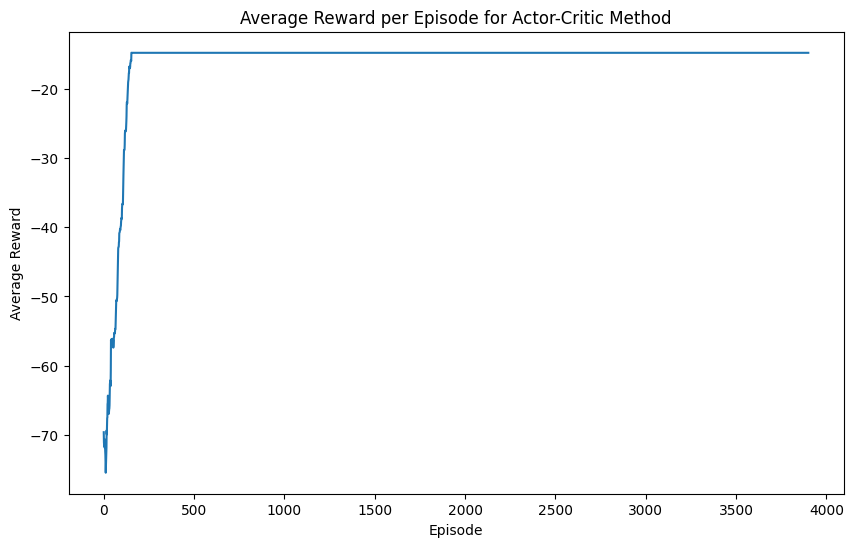

In [8]:
plt.figure(figsize=(10, 6))
plt.plot(moving_average(ac.reward, n=100))
plt.xlabel("Episode")
plt.ylabel("Average Reward")
plt.title("Average Reward per Episode for Actor-Critic Method")
plt.show()